In [1]:
# modular code
from master_functions_trains import *

In [2]:
# Example usage
np.random.seed(42)
params = [50, 80, 100, 110, 110, 5]  # Example parameter list

# params = [50, 5]  # Example parameter list

# params = [50, 80, 100, 110, 110, 100, 90, 80, 75, 70, 5]  # Example parameter list

# params = [50, 80, 100, 110, 118, 125, 130, 133, 135, 136, 5]  # Example parameter list


bl = 20 # baseline
dt = 0.05

ISI = 20  # frequency in Hz
n = len(params) - 1  # number of responses is one less than the length of params
x = np.arange(0, 140, dt)
# Generate the individual and combined alpha responses
# all_resp, y = model_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='alpha')

# add a baseline
idx = int(bl/dt) - 1

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))

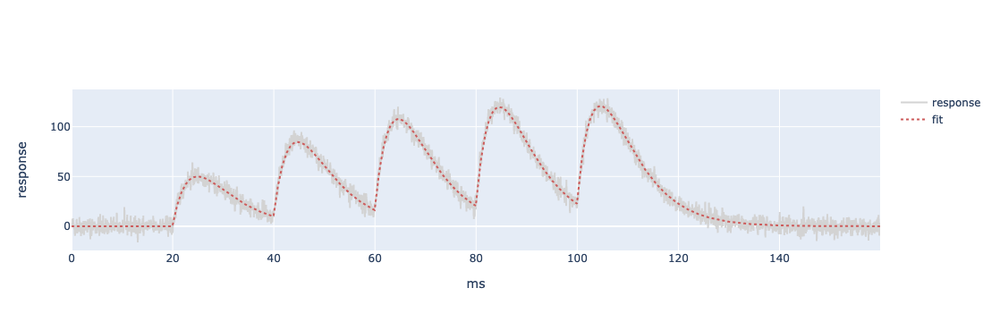

In [3]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
fig1.update_layout(
    xaxis_title='ms',
    yaxis_title='response',
)

fig1.show()   

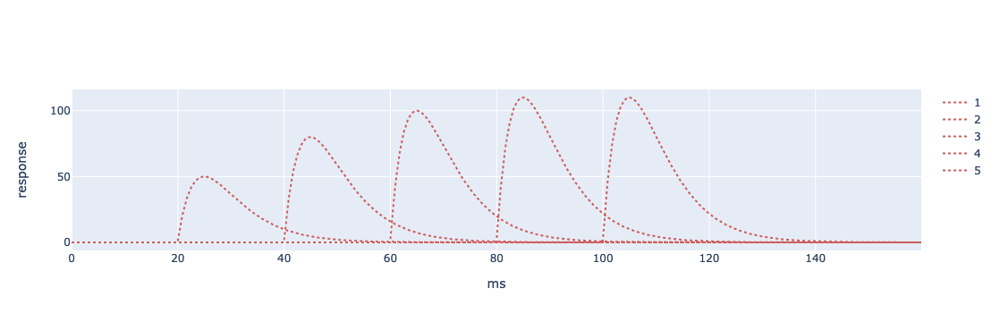

In [4]:
# Create the figure
fig2 = go.Figure()

# Plot each individual response
for i, yi in enumerate(all_y):
    fig2.add_trace(go.Scatter(x=x, y=yi, name=i+1, line=dict(color='indianred', dash='dot')))

# Set the axis labels
fig2.update_layout(
    xaxis_title='ms',
    yaxis_title='response',
)

fig2.show()   


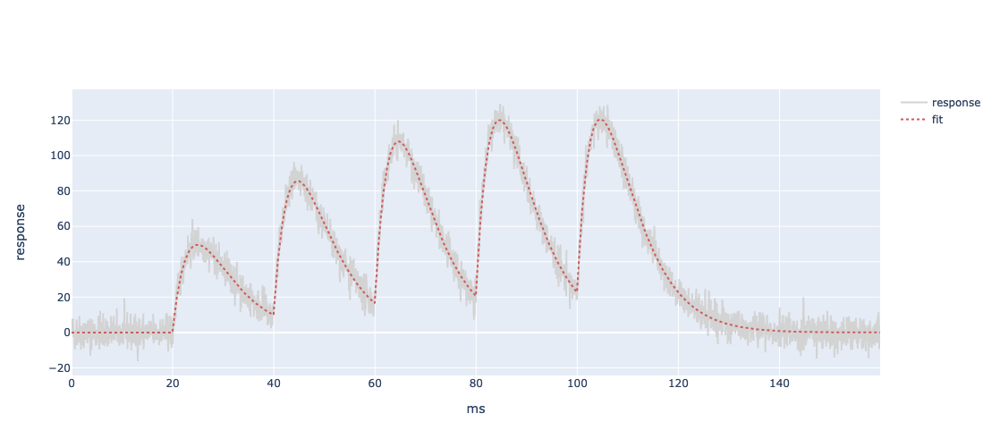

             A1      A2       A3       A4       A5      τ r20-80  d80-20  \
fit:     49.597  81.016  100.237  110.354  109.817  5.003  1.961  10.857   
AIC:  16921.376                                                            

          area  
fit:  6133.869  
AIC:            
CPU times: user 2.6 s, sys: 36.1 ms, total: 2.63 s
Wall time: 2.63 s


In [5]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='alpha', fit_method='DE', kinetics='fit', N=1)

In [6]:
# Example usage
np.random.seed(42)
params = [50, 80, 100, 5, 20, 30, 25, 15]  # Example parameter list [p11, p12, p13, T1, p21, p22, p23, T2]

params = [50, 80, 100, 110, 110, 5, 20, 30, 25, 15, 10, 15] 


bl = 20 # baseline
dt = 0.05
ISI = 20  
n = int(len(params)/2) - 1  # number of responses is one less than the length of params
x = np.arange(0, 140, dt)
# # Generate the individual and combined alpha responses
# all_resp, y = alpha2_alt_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='alpha2')

# add a baseline
idx = int(bl/dt) - 1

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))


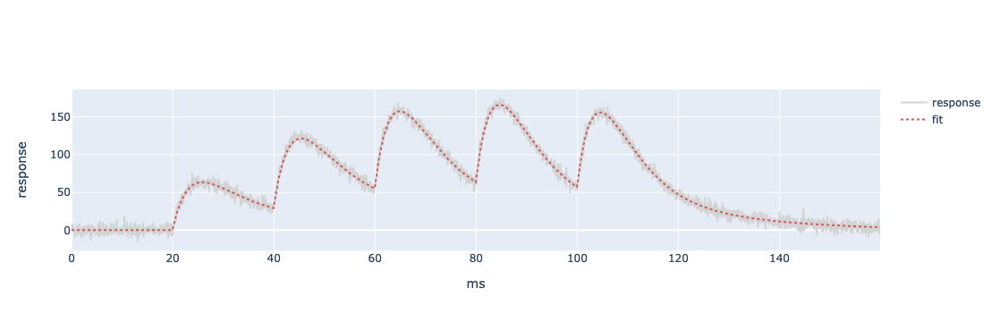

In [7]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
fig1.update_layout(
    xaxis_title='ms',
    yaxis_title='response',
)

fig1.show()  

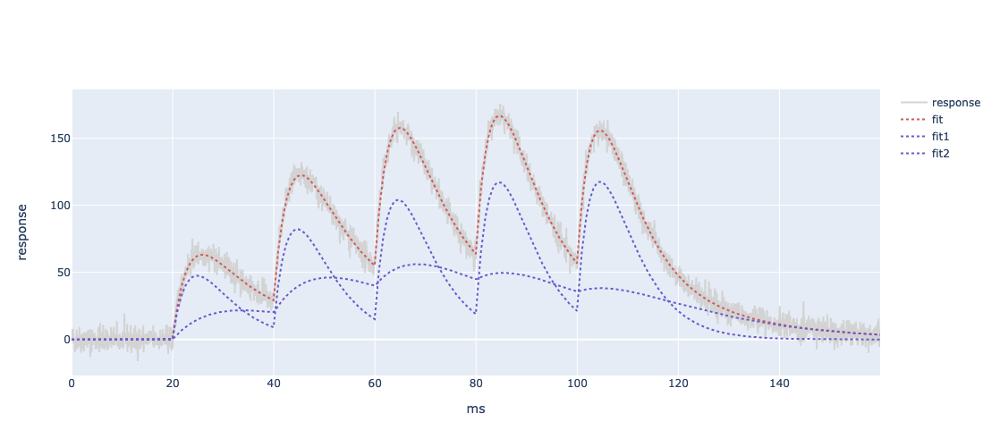

              A1         A2      A3       A4       A5       τ r20-80  d80-20  \
fast:     47.516     77.982  96.925  108.252  107.519   4.922  1.929   10.68   
slow:     21.764     32.932  29.294   18.092   13.434  13.799  5.409  29.942   
AIC:   16927.126  16927.126                                                    

           area  
fast:  5862.783  
slow:  4332.819  
AIC:             
CPU times: user 53 s, sys: 6.21 ms, total: 53 s
Wall time: 53.1 s


In [8]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='alpha2', N=30)

In [9]:
# Example usage
np.random.seed(42)
params = [30, 60, 80, 90, 5, 20]  # params of form [A1, A2, A3, A4, T1, T2]



bl = 20 # baseline
dt = 0.05
ISI = 20  
n = int(len(params)) - 2  # number of responses is one less than the length of params
x = np.arange(0, 160, dt)
# # Generate the individual and combined alpha responses
# all_resp, y = product_alt_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='product')

# add a baseline
idx = int(bl/dt) - 1

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))

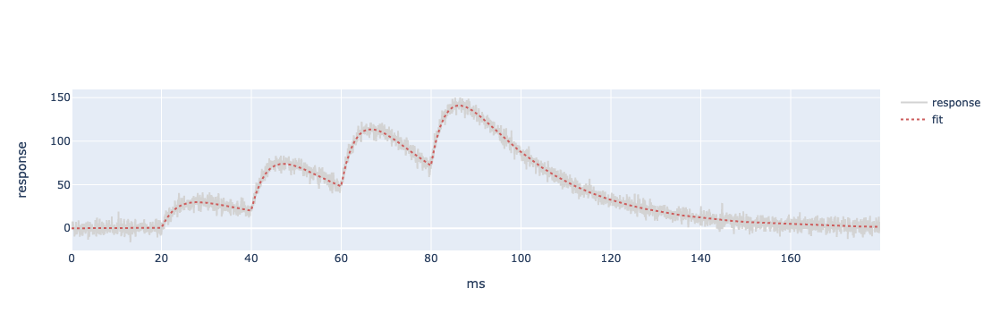

In [10]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
fig1.update_layout(
    xaxis_title='ms',
    yaxis_title='response',
)

fig1.show()  

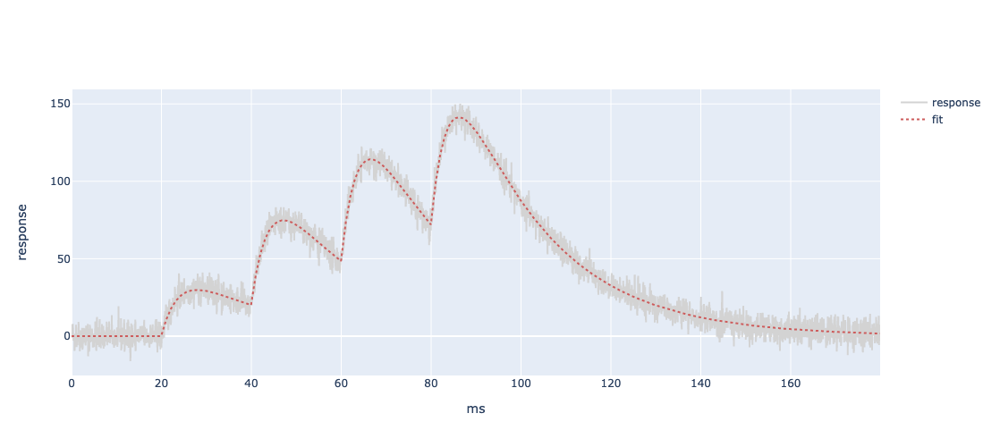

             A1      A2      A3      A4  τrise  τdecay  tpeak r20-80 d80-20  \
fit:     29.825  60.872  80.113  90.167  3.949  20.061  7.992  2.981  28.55   
AIC:  19406.456                                                               

          area  
fit:  7797.867  
AIC:            
CPU times: user 3.64 s, sys: 1.91 ms, total: 3.64 s
Wall time: 3.64 s


In [11]:
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='product', fit_method='LS')

In [12]:
# sum of 2 product
# params of form [A1, A2, A3, A4, T1, T2]

# Example usage
np.random.seed(42)
params = [50, 80, 100, 5, 10, 20, 30, 15, 15, 30]  # Example parameter list [A11, A12, A13, T11, T12, A21, A22, A23, T21, T22]

# params = [50, 5, 10, 100, 15, 30]  

bl = 20 # baseline
dt = 0.05
ISI = 20  
n = int(len(params)/2) - 2  # number of responses is one less than the length of params
x = np.arange(0, 160, dt)
# # Generate the individual and combined alpha responses
# all_resp, y = product2_alt_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='product2')

# add a baseline
idx = int(bl/dt) - 1
if idx < 0: idx=0

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))


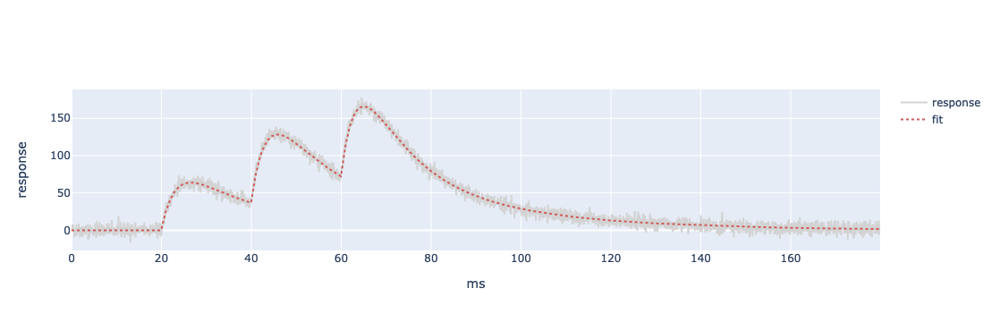

In [13]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
fig1.update_layout(
    xaxis_title='ms',
    yaxis_title='response',
)

fig1.show() 


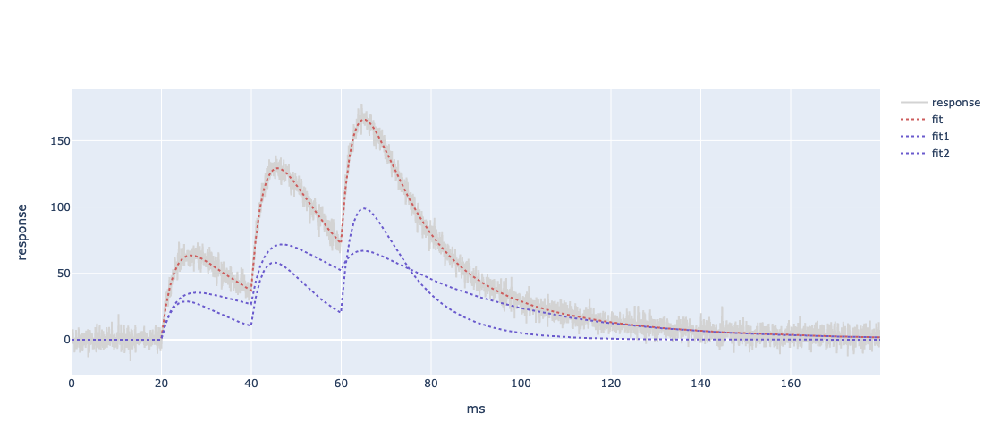

              A1      A2      A3  τrise  τdecay  tpeak r20-80  d80-20  \
fast:     35.531   50.84  24.224  3.174  30.719  8.034  2.859  42.773   
slow:     28.843  51.968  86.757  3.358  10.326   5.59   2.14   15.55   
AIC:   19411.879                                                        

           area  
fast:  4412.906  
slow:  2973.187  
AIC:             
CPU times: user 8.33 s, sys: 2.3 ms, total: 8.33 s
Wall time: 8.34 s


In [14]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='product2')

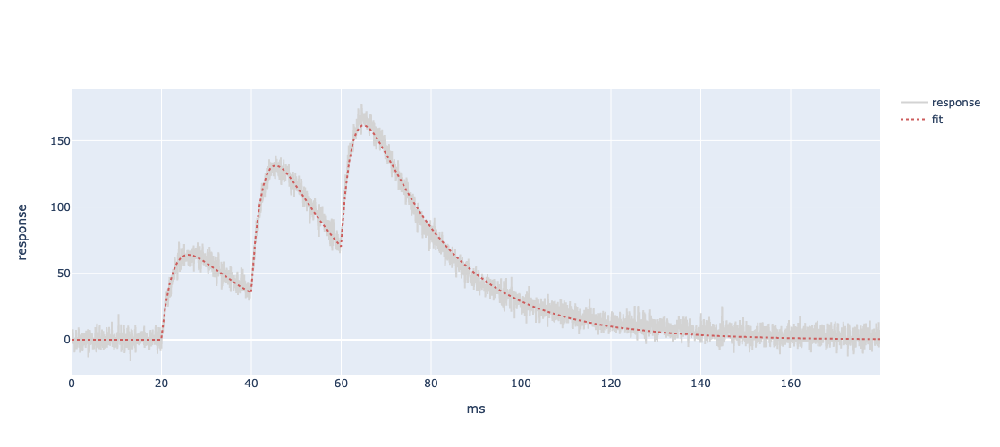

             A1       A2       A3  τrise  τdecay  tpeak r20-80 d80-20  \
fit:     63.952  105.191  109.221  2.667  18.676  6.056  2.211   26.2   
AIC:  20183.732                                                         

          area  
fit:  7189.748  
AIC:            
CPU times: user 2.5 s, sys: 2.06 ms, total: 2.51 s
Wall time: 2.51 s


In [15]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='product')

In [16]:
################ compare to previous code
from master_functions import *

In [17]:
# generate alpha response
np.random.seed(42) # set a seed to make egs reproducible
params = [50, 5] 
dt = 0.05
x = np.arange(0, 50, dt) 
y = alpha_alt(params, x) + np.random.normal(0,2,len(x))

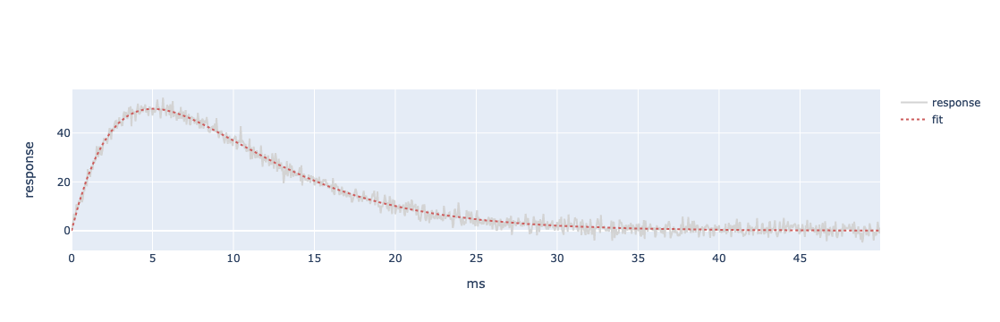

          peak      τ rise20-80 decay80-20     area
fit:    49.926  5.018     1.967     10.889  681.011
AIC:  4184.367                                     


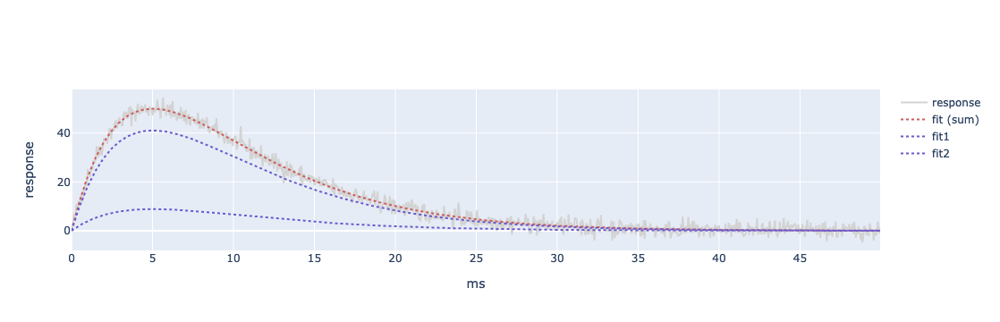

           peak      τ rise20-80 decay80-20     area
fast:    41.049  5.018     1.967     10.889  559.918
slow:     8.878  5.018     1.967     10.889  121.093
AIC:   4188.367                                     


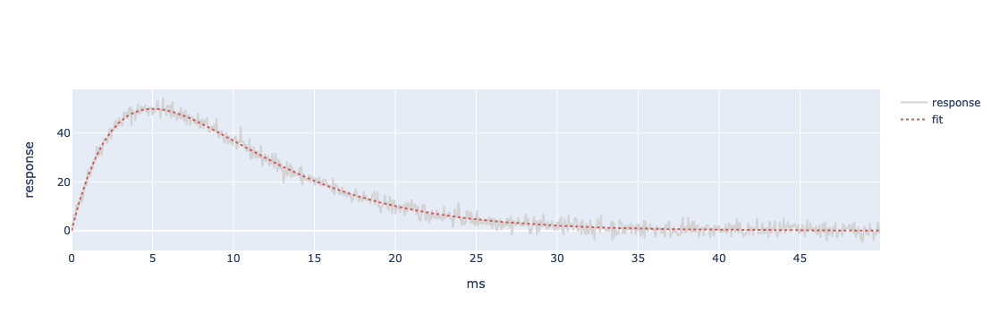

          peak  τrise τdecay  tpeak rise20-80 decay80-20     area
fit:    49.926  4.921  5.116  5.017     1.967     10.891  681.054
AIC:  4186.441                                                   


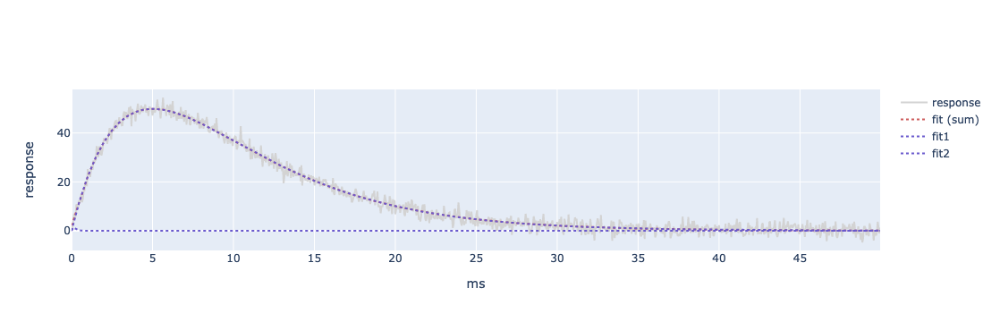

           peak  τrise τdecay  tpeak rise20-80 decay80-20     area
fast:     1.266  0.102  0.107  0.104     0.041      0.226    0.359
slow:    49.907  4.915  5.125  5.018     1.967     10.893  680.943
AIC:   4190.856                                                   


In [18]:
np.random.seed(42)
FITalpha(x, y)
FITalpha2(x, y)
FITproduct(x, y)
FITproduct2(x, y)

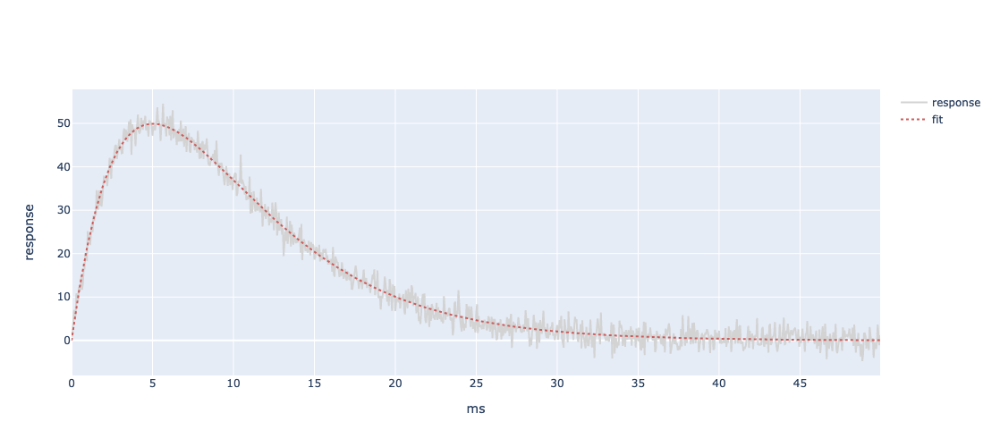

            A1      τ r20-80  d80-20     area
fit:    49.926  5.018  1.967  10.889  681.011
AIC:  4184.369                               


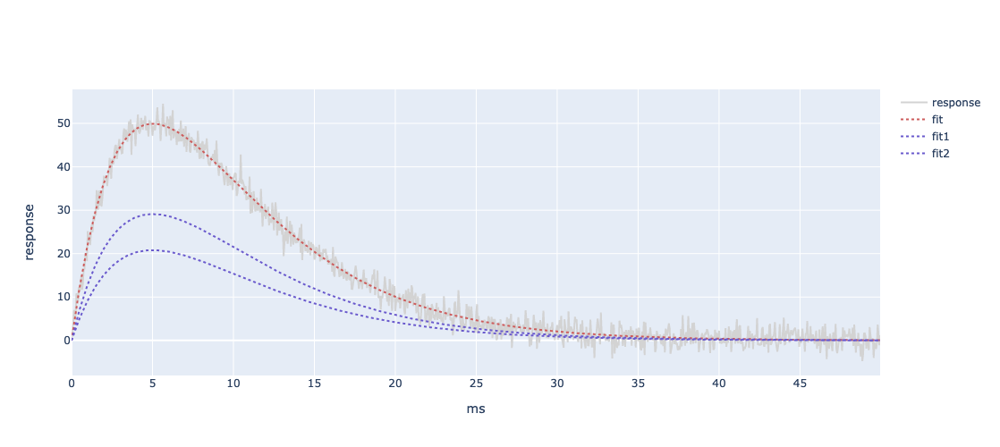

             A1         τ r20-80  d80-20     area
fast:    20.808     5.018  1.967  10.889  283.832
slow:    29.118     5.018  1.967  10.889  397.179
AIC:   4188.375  4188.375                        


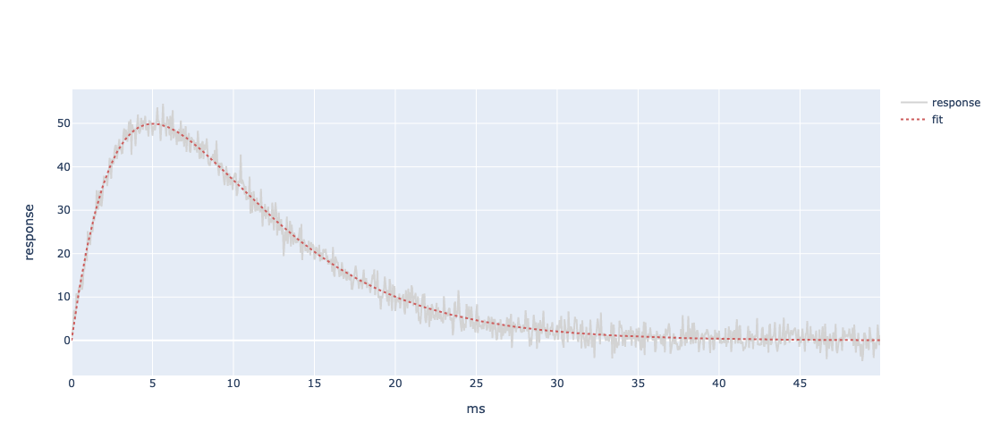

            A1  τrise τdecay  tpeak r20-80  d80-20     area
fit:    49.926  4.977  5.059  5.018  1.967  10.889  681.018
AIC:  4186.384                                             


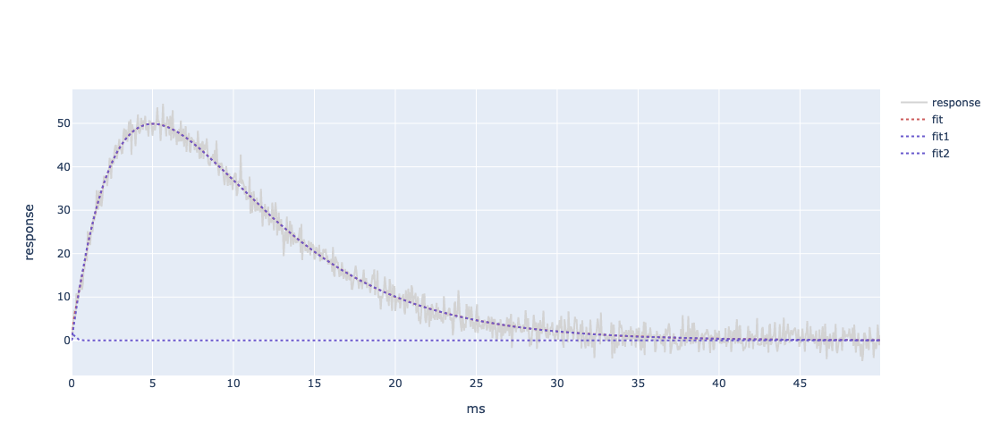

             A1  τrise τdecay  tpeak r20-80  d80-20     area
fast:     1.250  0.105  0.108  0.106  0.042   0.231    0.362
slow:    49.920  4.995  5.043  5.019  1.967  10.891  681.038
AIC:   4190.783                                             


In [19]:
np.random.seed(42) # need to examine this as weird behaviour
nFIT(x=x, y=y, model='alpha')
nFIT(x=x, y=y, model='alpha2')
nFIT(x=x, y=y, model='product')
nFIT(x=x, y=y, model='product2')

In [20]:
######################### fitting and comparing 4 fits to sum of 2 alpha functions #########################
# _alt versions take a1_max not a1 ie a1_max etc is the actual maximum of the alpha synapse
np.random.seed(42) # set a seed to make egs reproducible
params = [35, 5, 20, 25] 
dt = 0.05
x = np.arange(0, 150, dt) 
# y = alpha2(params, x) + np.random.normal(0,2,len(x))
y = alpha2_alt(params, x) + np.random.normal(0,2,len(x))

# y = model_n(params, ISI=0, n=1, x=x, model='alpha2')[1] + np.random.normal(0,2,len(x))


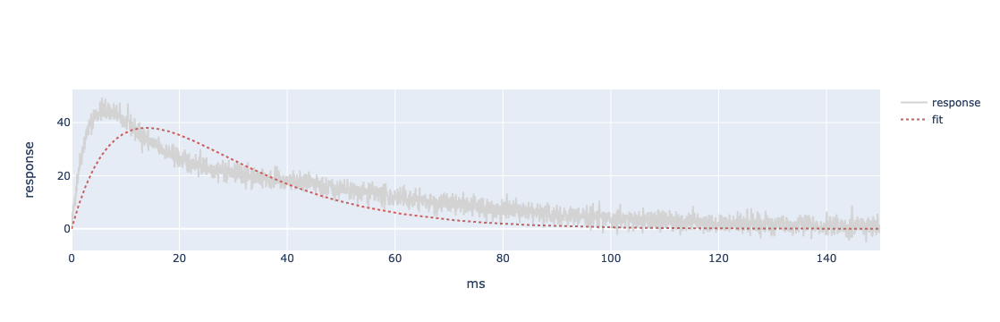

           peak       τ rise20-80 decay80-20      area
fit:     38.040  13.949     5.468     30.269  1442.424
AIC:  19198.264                                       


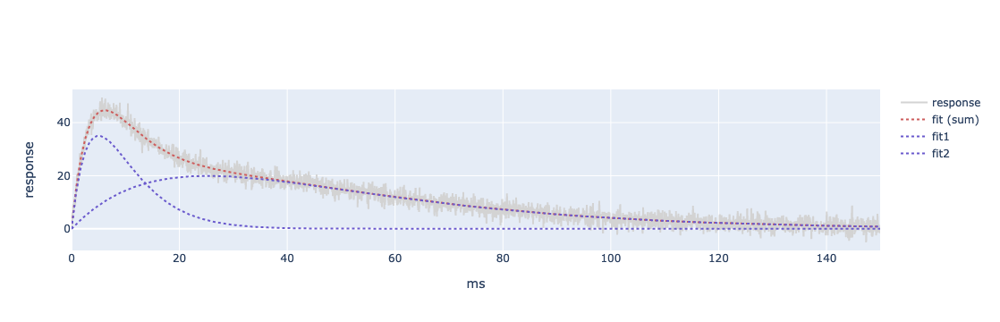

            peak       τ rise20-80 decay80-20      area
fast:     35.017   5.037     1.975     10.931   479.504
slow:     19.950  25.233     9.891     54.753  1368.404
AIC:   12596.360                                       


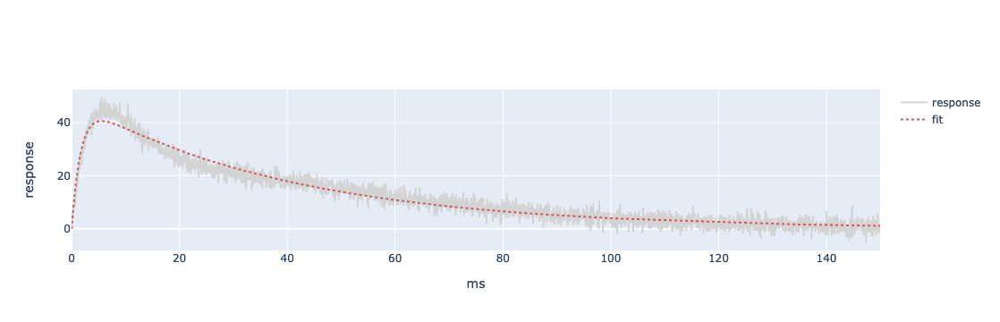

           peak  τrise  τdecay  tpeak rise20-80 decay80-20      area
fit:     40.584  1.693  39.928  5.587      1.82     55.355  1863.805
AIC:  13751.648                                                     


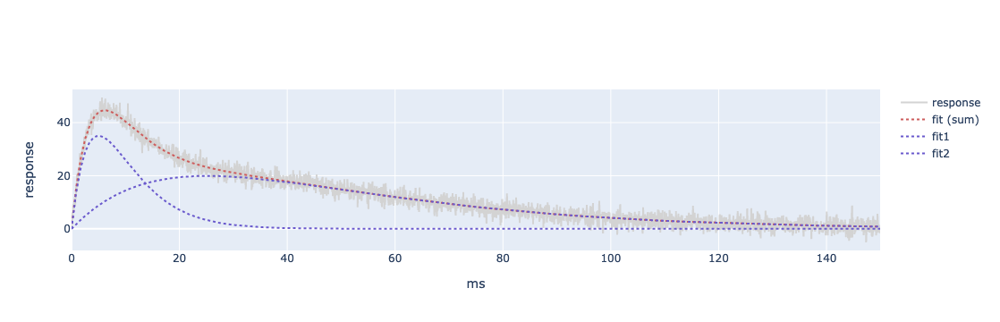

            peak   τrise  τdecay   tpeak rise20-80 decay80-20      area
fast:     35.016   4.875   5.205   5.036     1.974     10.938   479.632
slow:     19.945  24.653  25.824  25.229     9.889      54.77  1368.227
AIC:   12600.567                                                       


In [21]:
np.random.seed(42)
FITalpha(x, y)
FITalpha2(x, y)
FITproduct(x, y)
FITproduct2(x, y)

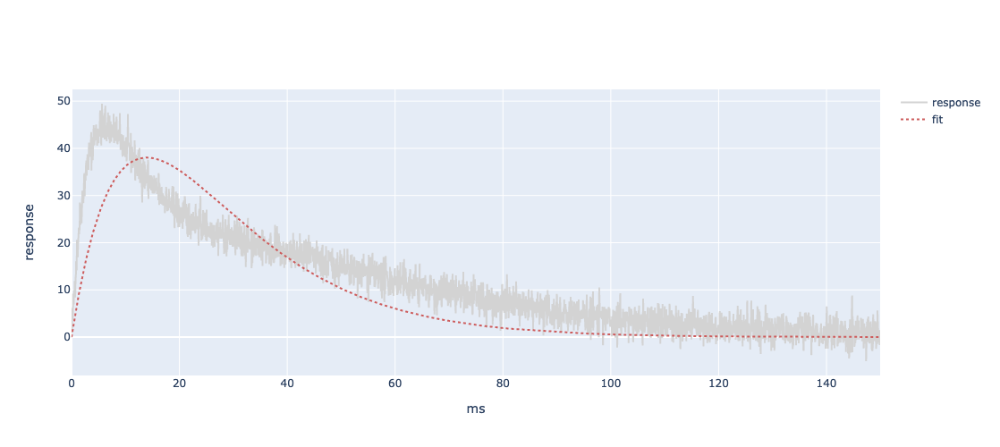

             A1       τ r20-80  d80-20      area
fit:     38.040  13.949  5.468  30.269  1442.419
AIC:  19198.264                                 


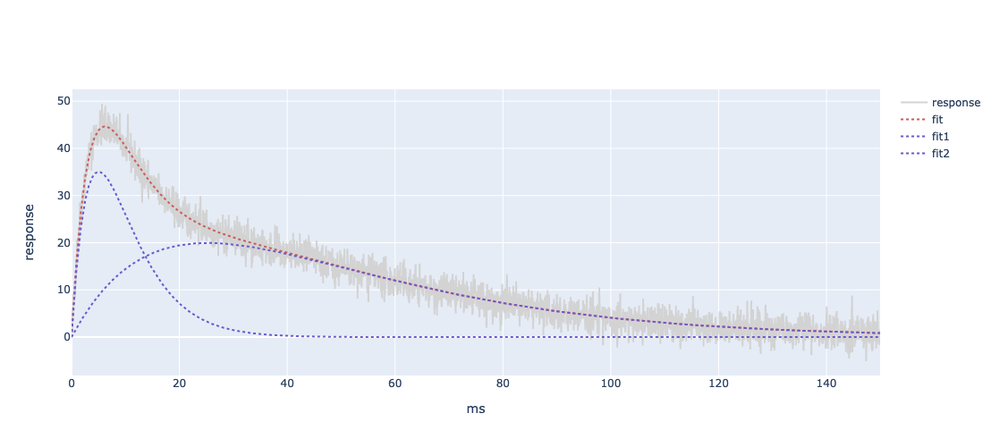

              A1          τ r20-80  d80-20      area
fast:     35.017      5.037  1.975  10.931   479.504
slow:     19.950     25.233  9.891  54.753  1368.404
AIC:   12596.362  12596.362                         


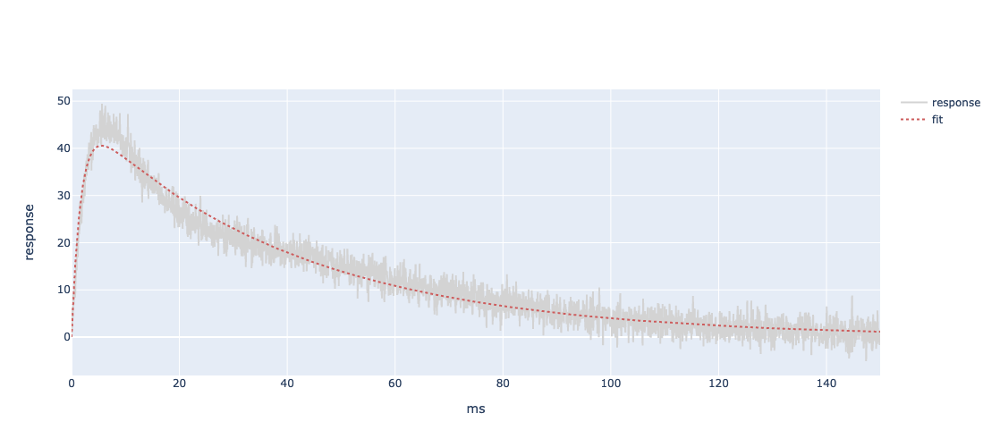

             A1  τrise  τdecay  tpeak r20-80  d80-20      area
fit:     40.584  1.693  39.928  5.587   1.82  55.356  1863.806
AIC:  13751.650                                               


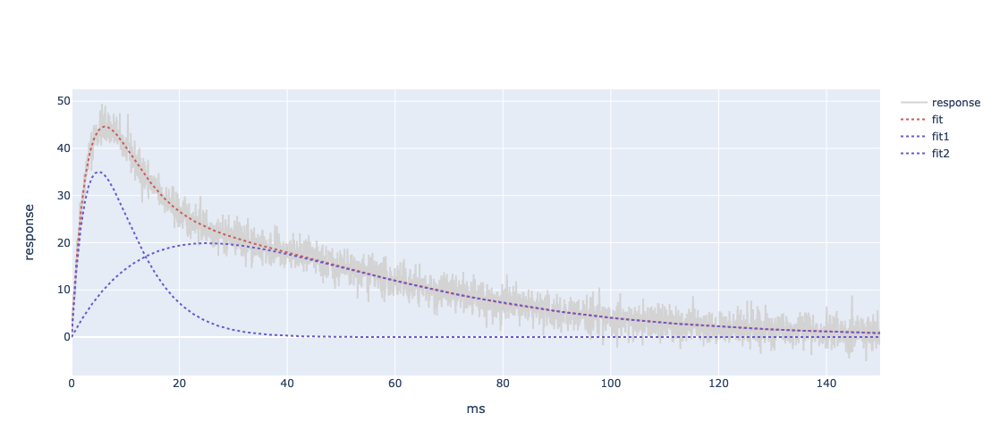

              A1   τrise  τdecay   tpeak r20-80  d80-20      area
fast:     35.029   4.574   5.548    5.03   1.97  10.996   481.151
slow:     19.909  24.464  26.072  25.251  9.897  54.837  1367.246
AIC:   12601.805                                                 


In [22]:
np.random.seed(2) # need to examine this as weird behaviour
nFIT(x=x, y=y, model='alpha')
nFIT(x=x, y=y, model='alpha2')
nFIT(x=x, y=y, model='product')
nFIT(x=x, y=y, model='product2')

In [23]:
np.random.seed(42) # set a seed to make egs reproducible
params = [50, 5, 20] 
dt = 0.05
x = np.arange(0, 150, dt) 
y = product_alt(params, x) + np.random.normal(0,2,len(x))


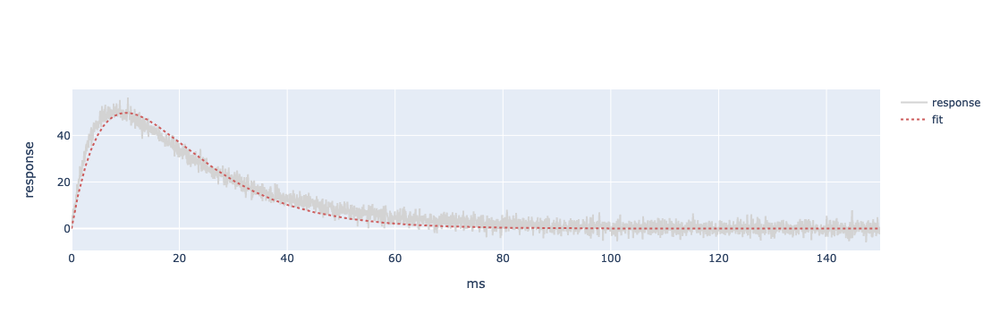

           peak       τ rise20-80 decay80-20      area
fit:     49.694  10.106     3.962      21.93  1365.183
AIC:  14766.944                                       


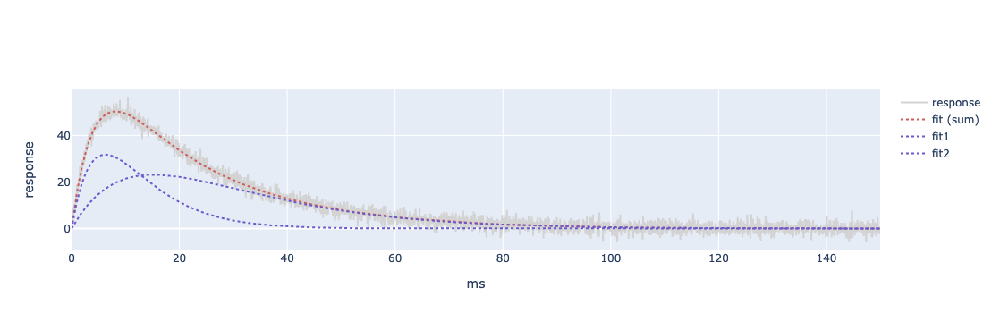

            peak       τ rise20-80 decay80-20     area
fast:     31.800   6.271     2.458     13.607  542.073
slow:     23.135  15.226     5.969      33.04  957.552
AIC:   12595.158                                      


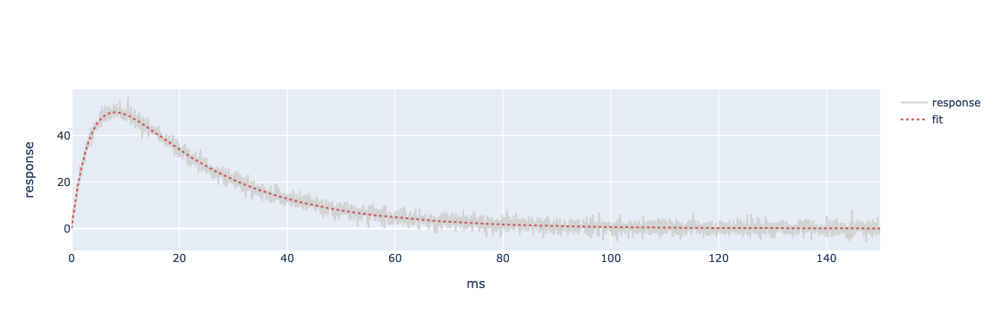

           peak  τrise  τdecay  tpeak rise20-80 decay80-20      area
fit:     49.961  3.984  20.179  8.054     3.005     28.757  1502.638
AIC:  12597.347                                                     


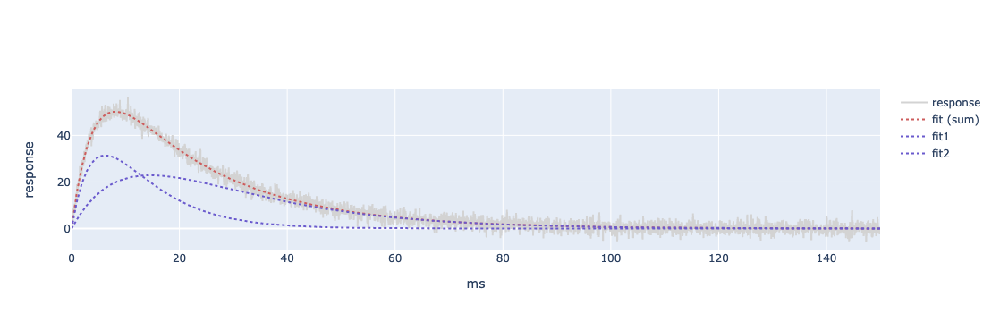

            peak   τrise  τdecay   tpeak rise20-80 decay80-20     area
fast:     31.447   4.682   8.594   6.247     2.432     14.593  559.055
slow:     22.901  11.292  19.436  14.634     5.705     33.686  945.065
AIC:   12595.143                                                      


In [24]:
np.random.seed(42)
FITalpha(x, y)
FITalpha2(x, y)
FITproduct(x, y)
FITproduct2(x, y)

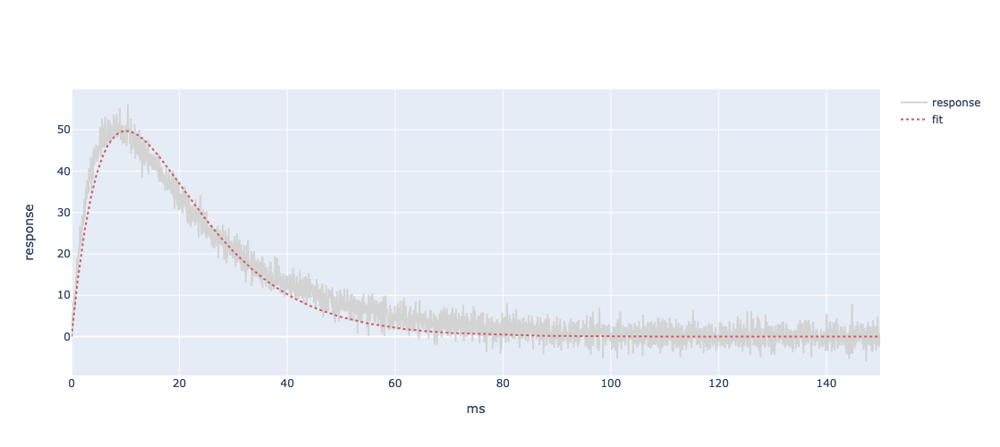

             A1       τ r20-80 d80-20      area
fit:     49.694  10.106  3.962  21.93  1365.183
AIC:  14766.945                                


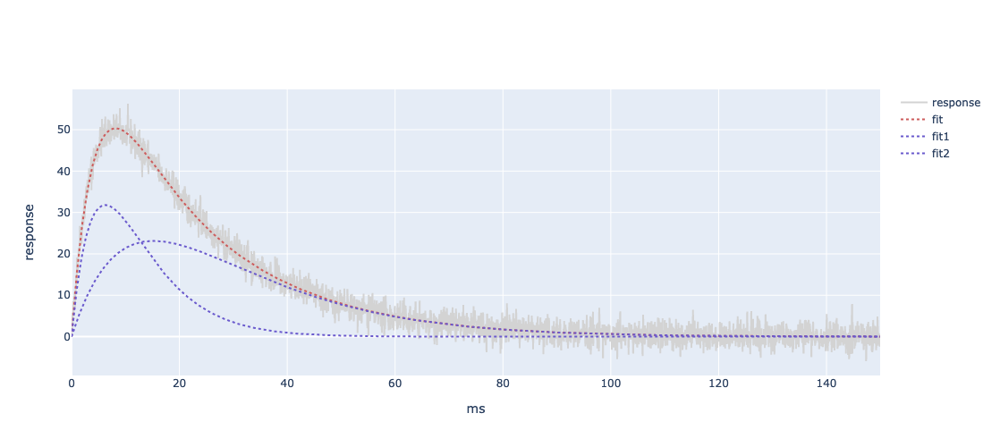

              A1          τ r20-80  d80-20     area
fast:     31.800      6.271  2.458  13.607  542.072
slow:     23.135     15.226  5.969   33.04  957.553
AIC:   12595.161  12595.161                        


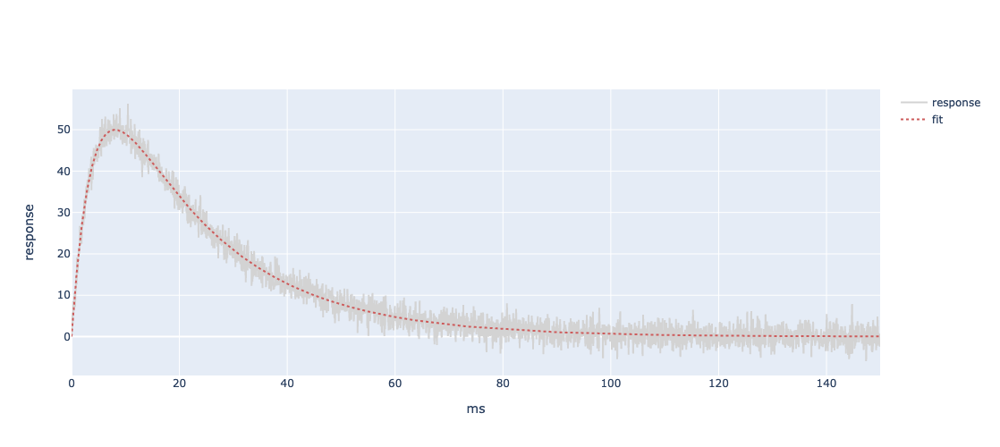

             A1  τrise  τdecay  tpeak r20-80  d80-20      area
fit:     49.961  3.984  20.179  8.054  3.005  28.757  1502.638
AIC:  12597.349                                               


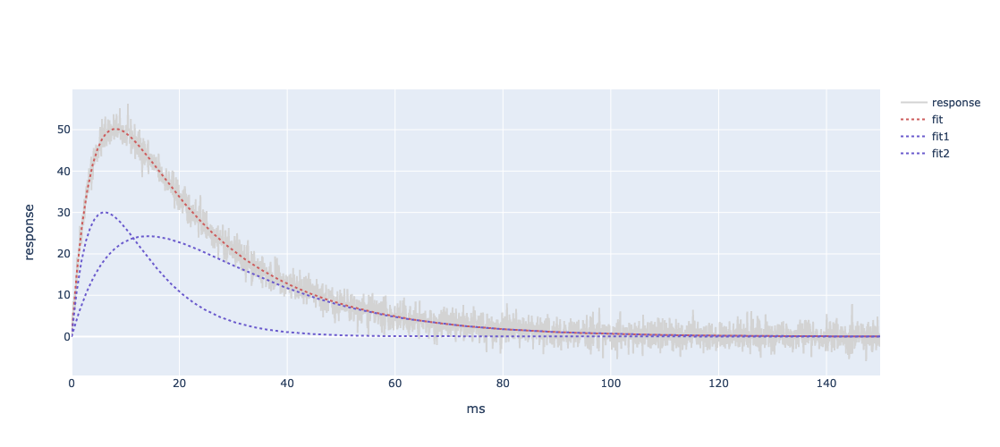

              A1   τrise  τdecay   tpeak r20-80  d80-20     area
fast:     30.054   4.743   8.143    6.14  2.394  14.125  520.176
slow:     24.298  10.569  19.699  14.199  5.526  33.294  984.145
AIC:   12595.157                                                


In [25]:
np.random.seed(42) 
nFIT(x=x, y=y, model='alpha')
nFIT(x=x, y=y, model='alpha2')
nFIT(x=x, y=y, model='product')
nFIT(x=x, y=y, model='product2')

In [26]:
np.random.seed(42) 
params = [35, 5, 15, 15, 10, 30] 
dt = 0.05
x = np.arange(0, 100, dt) 
# y = product2(params, x) + np.random.normal(0,2,len(x))
y = product2_alt(params, x) + np.random.normal(0,2,len(x))


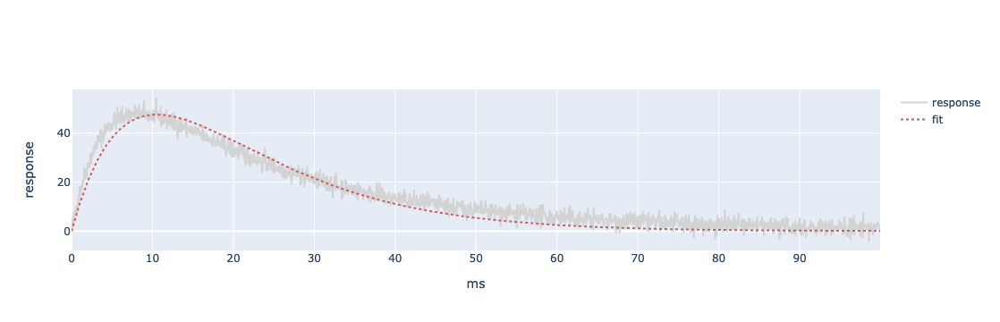

           peak       τ rise20-80 decay80-20      area
fit:     47.616  10.561      4.14     22.917  1366.978
AIC:  10670.003                                       


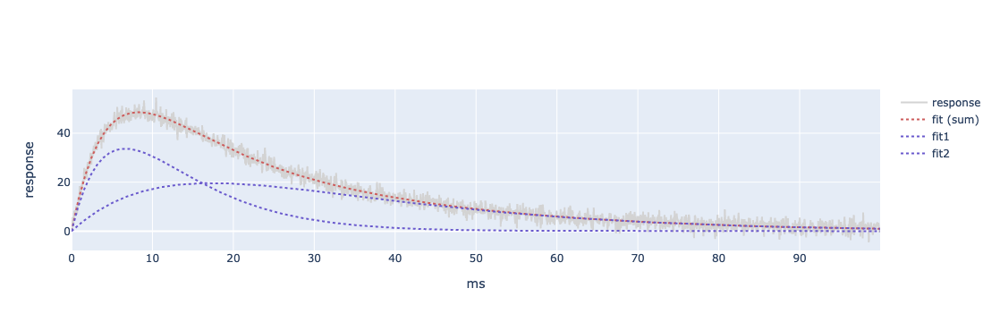

           peak       τ rise20-80 decay80-20     area
fast:    33.686   6.637     2.602     14.401  607.719
slow:    19.625  17.416     6.827     37.792  929.103
AIC:   8422.464                                      


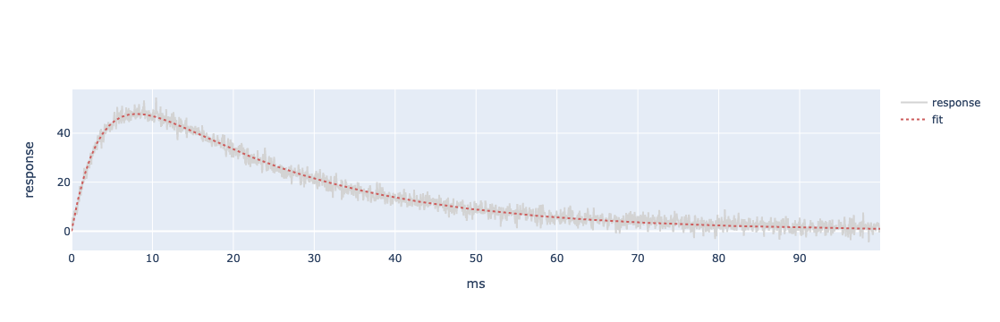

          peak  τrise  τdecay  tpeak rise20-80 decay80-20      area
fit:    47.885  3.764  22.301  8.057     2.976     31.497  1532.579
AIC:  8454.057                                                     


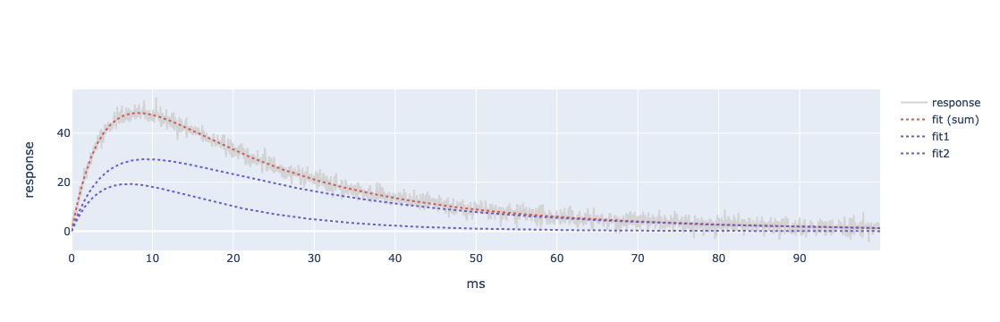

           peak  τrise  τdecay  tpeak rise20-80 decay80-20      area
fast:    19.267  4.275  12.833  7.047     2.701     19.402    428.18
slow:    29.412  4.277  27.104  9.377     3.448     38.164  1126.691
AIC:   8405.140                                                     


In [27]:
np.random.seed(42)
FITalpha(x, y)
FITalpha2(x, y)
FITproduct(x, y)
FITproduct2(x, y)

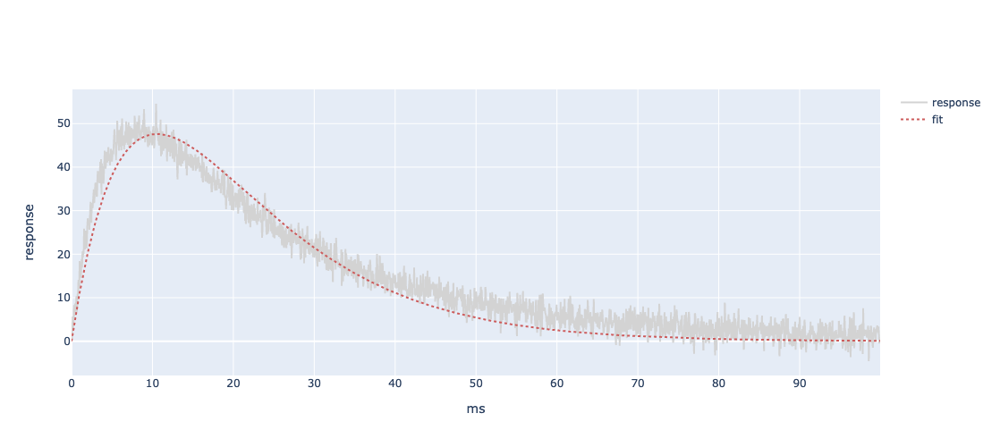

             A1       τ r20-80  d80-20      area
fit:     47.616  10.561   4.14  22.917  1366.978
AIC:  10670.004                                 


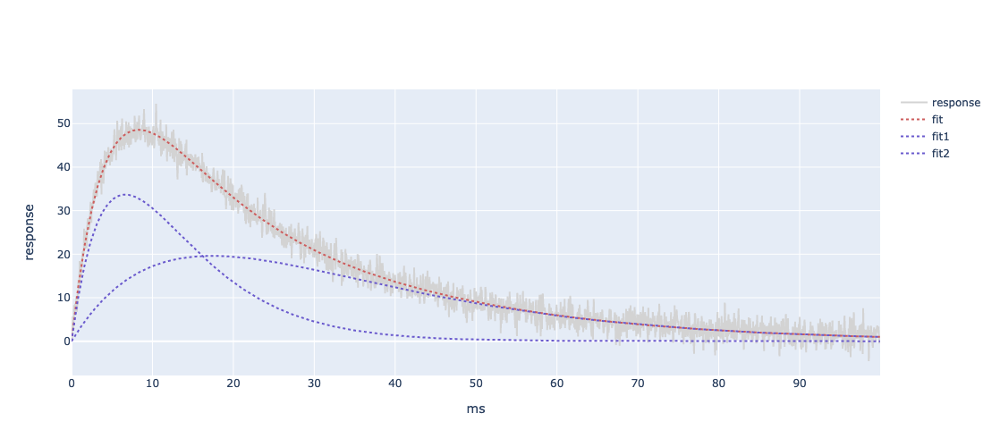

             A1         τ r20-80  d80-20     area
fast:    33.686     6.637  2.602  14.401  607.719
slow:    19.625    17.416  6.827  37.792  929.103
AIC:   8422.468  8422.468                        


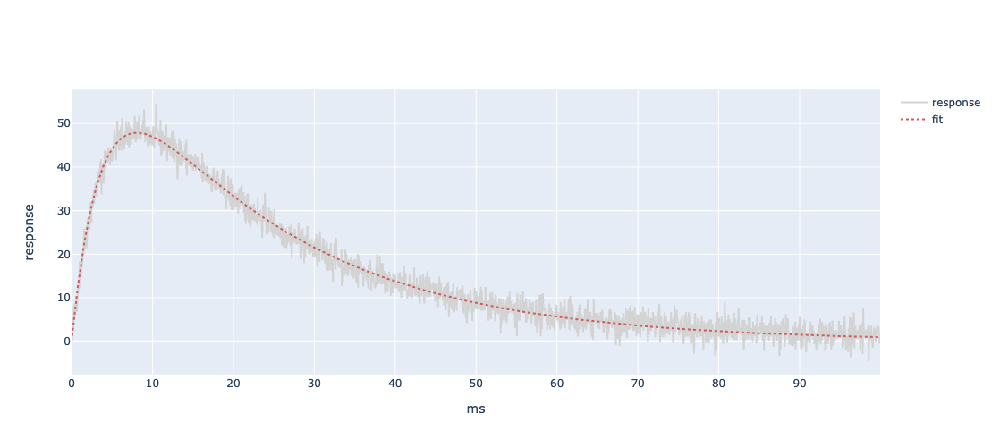

            A1  τrise  τdecay  tpeak r20-80  d80-20      area
fit:    47.885  3.764  22.301  8.057  2.976  31.497  1532.579
AIC:  8454.059                                               


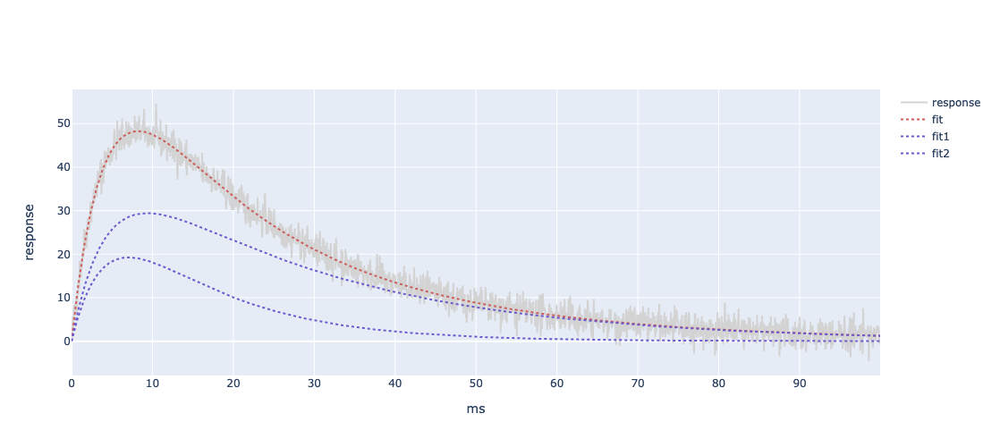

             A1  τrise  τdecay  tpeak r20-80  d80-20      area
fast:    19.256  4.276  12.831  7.048  2.701  19.399   427.925
slow:    29.422  4.276  27.101  9.376  3.447   38.16  1126.943
AIC:   8405.149                                               


In [28]:
np.random.seed(42) 
nFIT(x=x, y=y, model='alpha')
nFIT(x=x, y=y, model='alpha2')
nFIT(x=x, y=y, model='product')
nFIT(x=x, y=y, model='product2')

In [29]:
# batch examples

In [30]:
np.random.seed(42) # set a seed to make egs reproducible
bl = 20 # baseline
dt = 0.05
ISI = 20  
xmax = 220
rms = 2
n = 1

idx = int(bl/dt) - 1

x1 = np.arange(0, xmax-bl, dt)

params1 = [50, 10] 
y1 = model_n(params1, ISI=ISI, n=n, x=x1, model='alpha')[1]

y1 = np.concatenate([np.zeros(idx), y1])
x = np.arange(0, len(y1))*dt
y1 = y1 + np.random.normal(0, rms, len(x))

params2 = [30, 5, 35, 25] 
y2 = model_n(params2, ISI=ISI, n=n, x=x1, model='alpha2')[1]
y2 = np.concatenate([np.zeros(idx), y2])
y2 = y2 + np.random.normal(0, rms, len(x))

params3 = [50, 5, 20] 
y3 = model_n(params3, ISI=ISI, n=n, x=x1, model='product')[1]
y3 = np.concatenate([np.zeros(idx), y3])
y3 = y3 + np.random.normal(0, rms, len(x))

params4 = [20, 5, 10, 40, 15, 55] 
y4 = model_n(params4, ISI=ISI, n=n, x=x1, model='product2')[1]
y4 = np.concatenate([np.zeros(idx), y4])
y4 = y4 + np.random.normal(0, rms, len(x))

df = pd.DataFrame({'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4})

In [31]:
np.random.seed(42) # set a seed to make egs reproducible
bl = 20 # baseline
dt = 0.05
ISI = 50  
xmax = 240
rms = 2
n = 2

idx = int(bl/dt) - 1

x1 = np.arange(0, xmax-bl, dt)

params1 = [50, 70, 10] 
y1 = model_n(params1, ISI=ISI, n=n, x=x1, model='alpha')[1]

y1 = np.concatenate([np.zeros(idx), y1])
x = np.arange(0, len(y1))*dt
y1 = y1 + np.random.normal(0, rms, len(x))

# params2 = [30, 60, 5, 35, 45, 25] 
params2 = [50, 80, 5, 20, 30, 15] 
y2 = model_n(params2, ISI=ISI, n=n, x=x1, model='alpha2')[1]
y2 = np.concatenate([np.zeros(idx), y2])
y2 = y2 + np.random.normal(0, rms, len(x))

params3 = [50, 70, 5, 20] 
y3 = model_n(params3, ISI=ISI, n=n, x=x1, model='product')[1]
y3 = np.concatenate([np.zeros(idx), y3])
y3 = y3 + np.random.normal(0, rms, len(x))

params4 = [20, 30, 5, 10, 40, 60, 15, 55] 
y4 = model_n(params4, ISI=ISI, n=n, x=x1, model='product2')[1]
y4 = np.concatenate([np.zeros(idx), y4])
y4 = y4 + np.random.normal(0, rms, len(x))

df = pd.DataFrame({'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4})



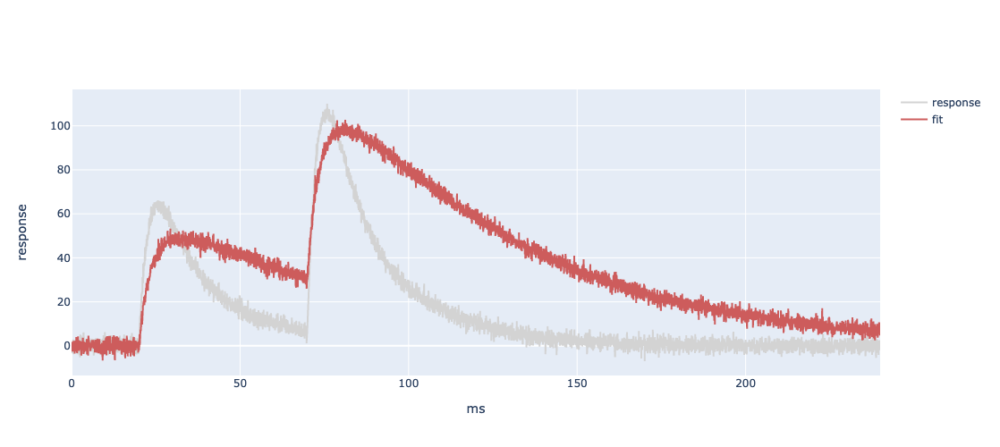

In [32]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y2, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y4, name='fit', line=dict(color='indianred')))

# Set the axis labels
# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')

fig1.show() 

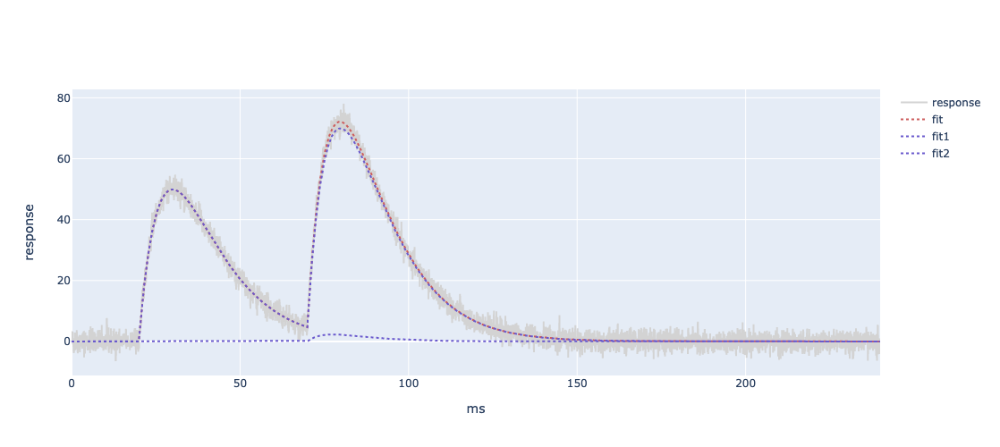

              A1      A2  τrise  τdecay  tpeak r20-80 d80-20      area
fast:      0.001   2.311  5.301  10.931  7.448  2.891  17.95    49.946
slow:     49.919  67.858  9.836   10.29  10.06  3.943  21.85  3221.419
AIC:   18582.455                                                      


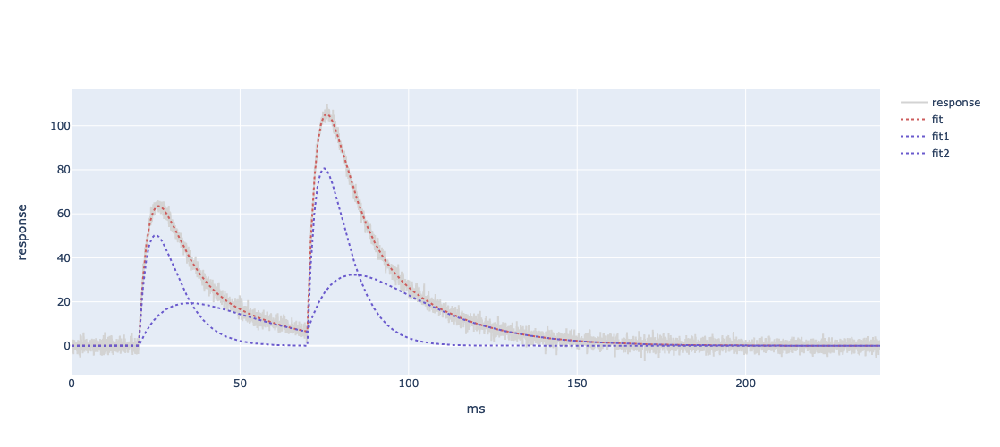

              A1      A2   τrise  τdecay   tpeak r20-80  d80-20      area
fast:     50.318  80.615   4.306   5.838   4.994  1.954   11.05  1798.259
slow:     19.441  29.162  13.936  16.405  15.103  5.917  81.689  2002.026
AIC:   18746.824                                                         


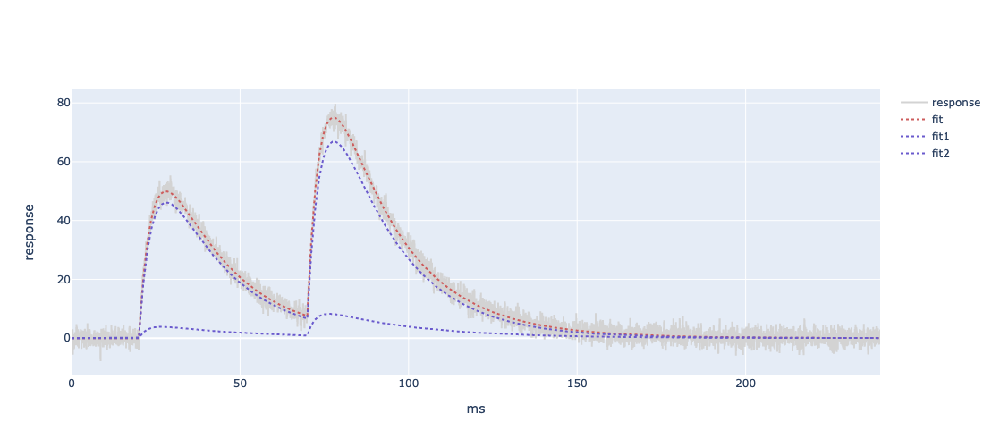

              A1      A2  τrise  τdecay  tpeak r20-80 d80-20      area
fast:      3.872   7.594  2.543  27.521  6.673  2.352  38.25   402.174
slow:     46.109  62.528  4.243  19.092  8.205  3.082  27.45  3187.568
AIC:   18580.974                                                      


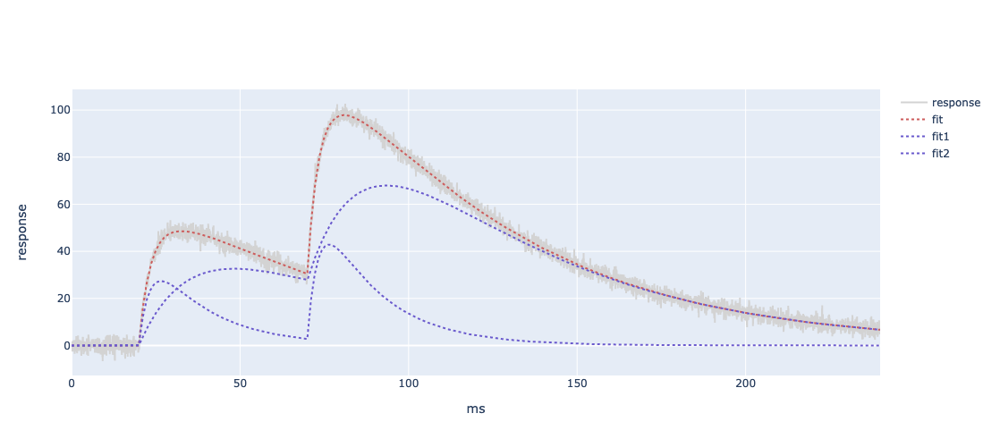

              A1      A2   τrise  τdecay   tpeak r20-80  d80-20      area
fast:     27.369  40.969    3.21  17.333   6.643  2.469    24.6  1737.711
slow:     32.646  49.125  16.521  54.646  28.327  10.81  81.366  7503.863
AIC:   18605.894                                                         


In [33]:
np.random.seed(42) # set a seed to make egs reproducible
out = nFITbatch(x, df, n=n, ISI=ISI, bl=bl, model='product2')

In [34]:
# common definitions
nsims = 100
dt = 0.05
x = np.arange(0, 100, dt) 
rms = 2
criterion = 'AIC'
fit_method = 'LS'
N = 10

bl = 20 # baseline
n = 1 # number of responses in a train
ISI = 50 # inter-stimulus interval
xmax = 150

fit_model = ['alpha', 'alpha2', 'product', 'product2']
fits_keys = ['fits1', 'fits2', 'fits3', 'fits4']
AIC_keys = ['AIC1', 'AIC2', 'AIC3', 'AIC4']
    
col_names_list = { 
    'fits1': get_column_names(model='alpha', n=n),
    'fits2': get_column_names(model='alpha2', n=n),
    'fits3': get_column_names(model='product', n=n),
    'fits4': get_column_names(model='product2', n=n)
}

idx = int(bl/dt) - 1
x1 = np.arange(0, xmax-bl, dt)
x = np.arange(0, xmax-dt, dt)


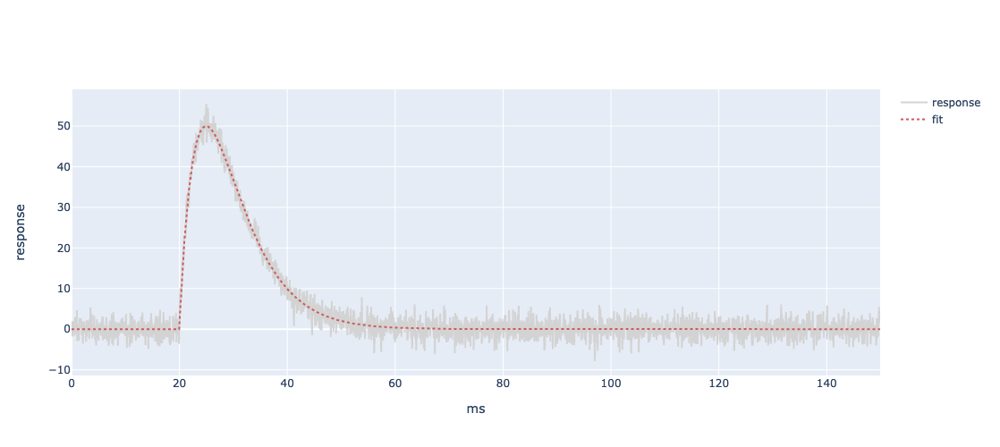

In [35]:
###################################################### sim1 ######################################################
# simulates alpha function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist1 = []
params = [50, 5] 

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist1.append(y)

# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig1 = go.Figure()
# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig1.show()  


In [36]:
# run sim
sim1 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist1):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim1[fits_key].append(fits)
        sim1[AIC_key].append(AIC)

100%|█████████████████████████████████████████| 100/100 [02:30<00:00,  1.50s/it]


In [37]:
df1_fits1 = extract_summary_stats(sim1, 'fits1', col_names=col_names_list['fits1'])
print(df1_fits1)

              A1      τ  r20-80  d80-20     area      σ
upper ci  50.354  5.037   1.975  10.930  683.648  2.111
mean      49.973  5.003   1.961  10.857  679.632  1.994
lower ci  49.649  4.973   1.949  10.791  676.091  1.859
median    49.959  5.004   1.961  10.858  679.661  1.999
sd         0.185  0.017   0.006   0.036    1.861  0.068


In [38]:
print(IC_model(data_dict=sim1, model=0, criterion='AIC'))

0.84


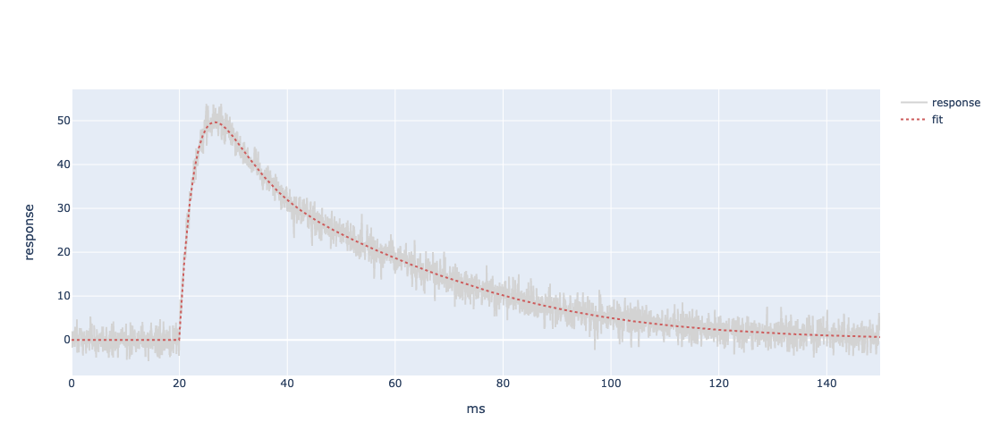

In [40]:
###################################################### sim2 ######################################################
# simulates alpha2 function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist2 = []
params = [35, 5, 25, 20] 

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha2')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist2.append(y)

# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha2')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig2 = go.Figure()
# Add the original data
fig2.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig2.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig2.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig2.show()  


In [41]:
# run sim
sim2 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist2):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim2[fits_key].append(fits)
        sim2[AIC_key].append(AIC)

100%|█████████████████████████████████████████| 100/100 [01:09<00:00,  1.43it/s]


In [42]:
df2_fits2 = extract_summary_stats(sim2, 'fits2', col_names=col_names_list['fits2'])
print(df2_fits2)

              A1      τ  r20-80  d80-20     area      A1       τ  r20-80  \
upper ci  35.461  5.078   1.991  11.019  486.374  25.374  20.232   7.931   
mean      34.970  5.005   1.962  10.861  475.795  24.997  19.993   7.837   
lower ci  34.417  4.936   1.935  10.710  464.276  24.645  19.725   7.733   
median    34.958  5.008   1.963  10.866  475.613  24.996  19.989   7.836   
sd         0.254  0.042   0.017   0.092    5.914   0.218   0.126   0.049   

          d80-20      area      σ  
upper ci  43.901  1370.830  2.111  
mean      43.384  1358.488  1.994  
lower ci  42.803  1346.219  1.859  
median    43.374  1358.422  1.999  
sd         0.274     6.395  0.068  


In [43]:
print(IC_model(data_dict=sim2, model=1, criterion='AIC'))

0.99


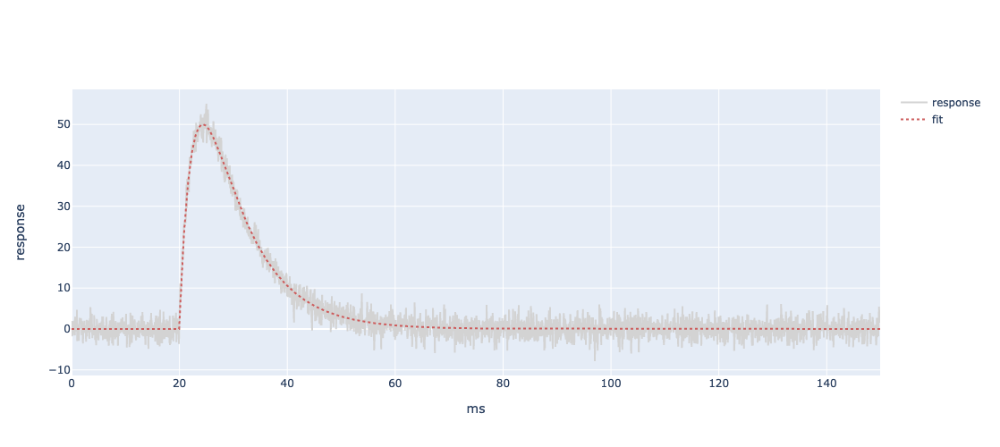

In [44]:
###################################################### sim3 ######################################################
# simulates alpha2 function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist3 = []
params = [50, 4, 8] 

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='product')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist3.append(y)

# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='product')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig3 = go.Figure()
# Add the original data
fig3.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig3.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig3.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig3.show()  

In [45]:
# run sim
sim3 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist3):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim3[fits_key].append(fits)
        sim3[AIC_key].append(AIC)

100%|█████████████████████████████████████████| 100/100 [01:52<00:00,  1.13s/it]


In [46]:
df3_fits3 = extract_summary_stats(sim3, 'fits3', col_names=col_names_list['fits3'])
print(df3_fits3)

              A1  τrise  τdecay  tpeak  r20-80  d80-20     area      σ
upper ci  50.352  2.760   8.230  4.454   1.710  12.328  697.708  2.111
mean      49.974  2.666   8.011  4.395   1.684  12.110  692.995  1.994
lower ci  49.623  2.561   7.816  4.331   1.655  11.932  688.683  1.859
median    49.974  2.669   8.002  4.398   1.686  12.095  692.729  1.999
sd         0.194  0.052   0.108  0.031   0.014   0.102    2.587  0.068


In [47]:
print(IC_model(data_dict=sim3, model=2, criterion='AIC'))

0.8


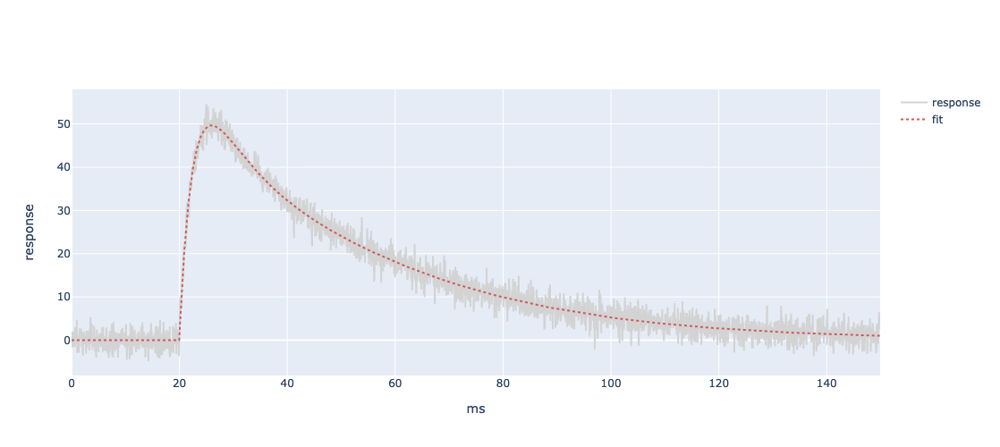

In [48]:
###################################################### sim4 ######################################################
# simulates alpha2 function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist4 = []
params = [35, 4, 8, 25, 20, 30] 

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='product2')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist4.append(y)


# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='product2')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig4 = go.Figure()
# Add the original data
fig4.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig4.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig4.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig4.show()  

In [49]:
# run sim
sim4 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist4):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim4[fits_key].append(fits)
        sim4[AIC_key].append(AIC)

100%|█████████████████████████████████████████| 100/100 [02:06<00:00,  1.26s/it]


In [50]:
df4_fits4 = extract_summary_stats(sim4, 'fits4', col_names=col_names_list['fits4'])
print(df4_fits4)

              A1  τrise  τdecay  tpeak  r20-80  d80-20     area      A1  \
upper ci  37.417  3.781   9.603  4.610   1.750  13.994  574.844  33.739   
mean      31.296  3.094   6.441  4.177   1.615  10.687  403.563  28.264   
lower ci  25.056  2.435   3.952  3.709   1.453   8.082  253.796  22.208   
median    31.664  2.965   5.987  4.158   1.619   9.951  381.762  28.380   
sd         4.538  0.457   3.290  0.382   0.118   4.039  175.351   4.390   

           τrise  τdecay   tpeak  r20-80  d80-20      area      σ  
upper ci  14.726  32.956  19.967   7.758  47.917  1623.148  2.111  
mean       9.562  30.774  15.965   6.092  46.238  1466.482  1.994  
lower ci   5.132  28.068  11.241   4.128  45.564  1282.397  1.859  
median     9.268  31.058  16.049   6.116  46.572  1487.362  1.999  
sd         2.621   2.995   2.668   1.089   3.925   177.187  0.068  


In [51]:
print(IC_model(data_dict=sim4, model=3, criterion='AIC'))

1.0


In [52]:
print(IC_model(data_dict=sim4, model=1, criterion='AIC'))

0.0


In [ ]:
# ################################### to save for analysis ###################################
# names = ['sim1', 'sim2', 'sim3', 'sim4']

# # Create a dictionary only with the variables that are defined
# list_dict = {}
# for name in names:
#     var = locals().get(name)
#     if var is not None:
#         list_dict[name] = var

# # # Print out the names of variables that have been found and added to the dictionary
# # print(f"Variables found and added to the dictionary: {', '.join(list_dict.keys())}")

# # create dir to save data in
# sim_dir = "curve fits"
# if not os.path.exists(sim_dir):
#     os.mkdir(sim_dir)

# # Save the dictionaries as pickle files for each name
# for name, sim_data in list_dict.items():
#     file_path = '{}/{}.pickle'.format(sim_dir, name)
#     with open(file_path, 'wb') as handle:
#         pickle.dump(sim_data, handle, protocol=pickle.HIGHEST_PROTOCOL)